In [4]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"
TORCH_CUDA_ARCH_LIST="8.6"
import cv2
import time
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from glob import glob
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.backends.cudnn as cudnn
import torchvision.transforms.functional as TF
import torchvision.transforms as transformtransforms
from tqdm import tqdm
from torchsummary import summary
from torchvision import transforms
from torchvision.transforms import ToPILImage
from torch.utils.data import Dataset, DataLoader
time_start_all = time.time()
image_size = 64
LR = 0.0002
NOISE = 100
EPOCH = 25
BATCH = 50
NUM_WORKERS = 0
SEED = 69

print('torch.version: ',torch. __version__)
print('torch.version.cuda: ',torch.version.cuda)
print('torch.cuda.is_available: ',torch.cuda.is_available())
print('torch.cuda.device_count: ',torch.cuda.device_count())
print('torch.cuda.current_device: ',torch.cuda.current_device())
device_default = torch.cuda.current_device()
torch.cuda.device(device_default)
print('torch.cuda.get_device_name: ',torch.cuda.get_device_name(device_default))
device = torch.device("cuda")
# print(torch.cuda.get_arch_list())


#loading the dataset
transform=transforms.Compose([transforms.Resize(image_size),
                              transforms.CenterCrop(image_size),
                              transforms.ToTensor(),
                              transforms.Normalize((0.5, 0.5, 0.5), 
                                                   (0.5, 0.5, 0.5)),])


dataset = torchvision.datasets.CIFAR10(root="./data/", 
                                       download=True,
                                       transform=transform)

dataloader = torch.utils.data.DataLoader(dataset, 
                                         batch_size=BATCH,
                                         shuffle=True, 
                                         num_workers=NUM_WORKERS)


print(dataset.classes)
print(dataset.data.shape)


class Generator(nn.Module):
    def __init__(self, noise = NOISE):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(noise, 512, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

    def initialize_weights(self, w_mean=0, w_std=0.02, b_mean=1, b_std=0.02):
        for m in self.modules():
            classname = m.__class__.__name__
            if classname.find('Conv') != -1:
                nn.init.normal_(m.weight.data, w_mean, w_std)
            elif classname.find('BatchNorm') != -1:
                nn.init.normal_(m.weight.data, b_mean, b_std)
                nn.init.constant_(m.bias.data, 0)

device = torch.device("cuda")
G = Generator().to(device)
summary(G, input_size=(100,1,1))



class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

    def initialize_weights(self, w_mean=0, w_std=0.02, b_mean=1, b_std=0.02):
        for m in self.modules():
            classname = m.__class__.__name__
            if classname.find('Conv') != -1:
                nn.init.normal_(m.weight.data, w_mean, w_std)
            elif classname.find('BatchNorm') != -1:
                nn.init.normal_(m.weight.data, b_mean, b_std)
                nn.init.constant_(m.bias.data, 0)

device = torch.device("cuda")
D = Discriminator().to(device)
summary(D, input_size=(3,64,64))



def norm(data):
    data = ((data-np.min(data))/(np.max(data)-np.min(data))*255).astype(np.uint8)
    return data

def G_fake_images(fake_images):
    # noise = torch.randn(10, NOISE, 1, 1, device=device)
    # fake = G(noise)
    
    frames_1 = np.array([])
    for i in range(0,5):
        frame_i = fake[i].detach().permute(1,2,0).cpu().numpy()
        # frame_i = cv2.resize(frame_i, (128,128))
        if i == 0:
            frames_1 = frame_i
        else:
            frames_1 = np.hstack((frames_1,frame_i))
            
    frames_2 = np.array([])            
    for i in range(5,10):
        frame_i = fake[i].detach().permute(1,2,0).cpu().numpy()
        # frame_i = cv2.resize(frame_i, (128,128))
        if i == 5:
            frames_2 = frame_i
        else:
            frames_2 = np.hstack((frames_2,frame_i))
        
    frames = np.vstack((frames_1,frames_2))
    frames = cv2.cvtColor(frames, cv2.COLOR_BGR2RGB)
    frames = ((frames-np.min(frames))/(np.max(frames)-np.min(frames))*255).astype(np.uint8)
    return frames

'''
loss & optimizer
'''
torch.cuda.is_available()
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
criterion = nn.BCELoss()
optimizerG = optim.Adam(G.parameters(), lr=LR, betas=(0.5, 0.999))
optimizerD = optim.Adam(D.parameters(), lr=LR, betas=(0.5, 0.999))
input_noise = torch.randn(BATCH, NOISE, 1, 1)
input_noise = input_noise.to(device)
real_label = 1.0
fake_label = 0.0



torch.version:  2.1.2
torch.version.cuda:  12.1
torch.cuda.is_available:  True
torch.cuda.device_count:  1
torch.cuda.current_device:  0
torch.cuda.get_device_name:  Tesla V100-PCIE-32GB
Files already downloaded and verified
['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
(50000, 32, 32, 3)
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9    

start training...


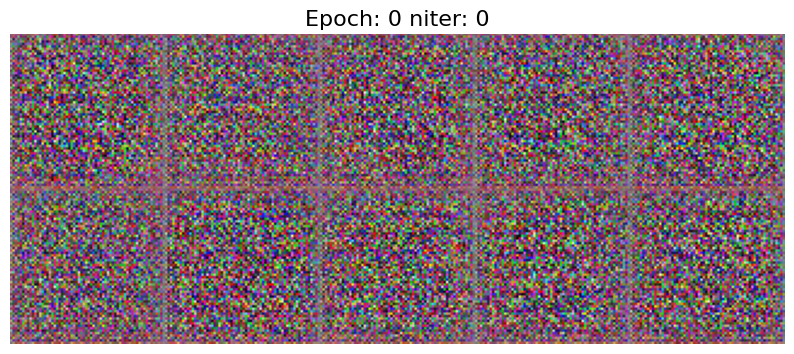

[0/25][0/1000] Loss_D: 1.5250 Loss_G: 3.2224 D(x): 0.4498 D(G(z)): 0.5015 / 0.0407


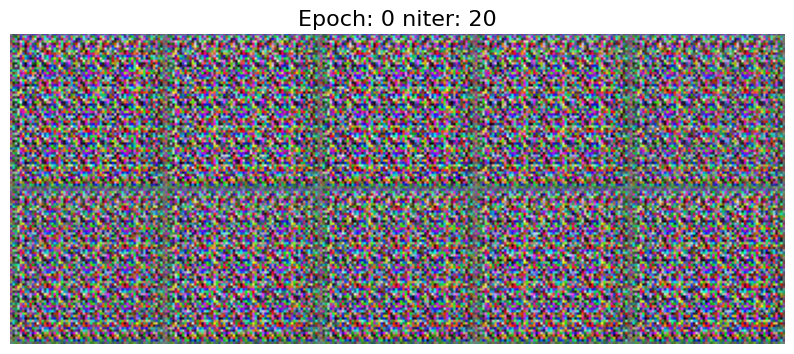

[0/25][20/1000] Loss_D: 1.5970 Loss_G: 12.6490 D(x): 0.8838 D(G(z)): 0.7592 / 0.0000


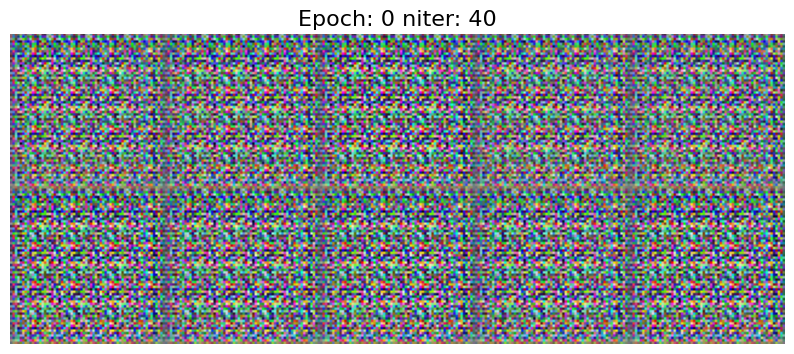

[0/25][40/1000] Loss_D: 0.4718 Loss_G: 13.7819 D(x): 0.6864 D(G(z)): 0.0000 / 0.0000


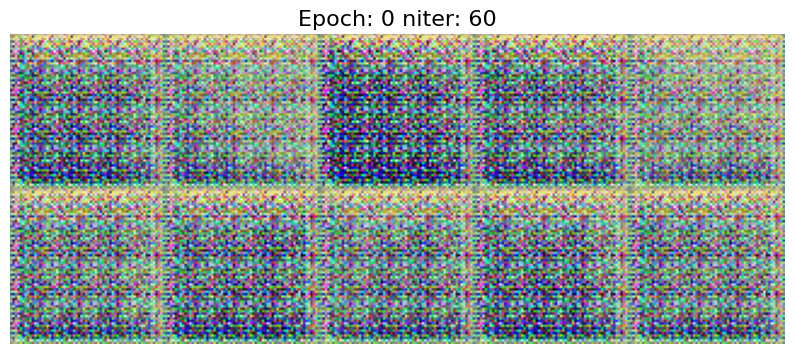

[0/25][60/1000] Loss_D: 0.1570 Loss_G: 9.2978 D(x): 0.8701 D(G(z)): 0.0002 / 0.0002


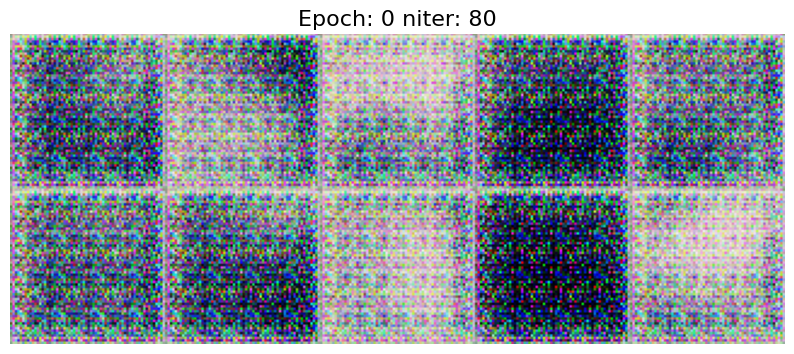

[0/25][80/1000] Loss_D: 0.2012 Loss_G: 5.3779 D(x): 0.8980 D(G(z)): 0.0775 / 0.0057


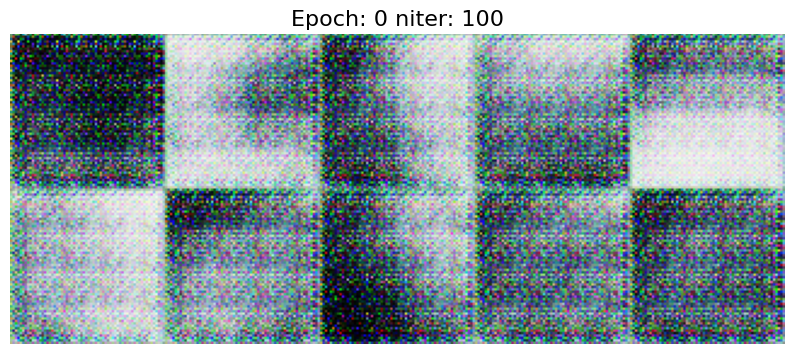

[0/25][100/1000] Loss_D: 0.6311 Loss_G: 6.1512 D(x): 0.9701 D(G(z)): 0.4313 / 0.0027


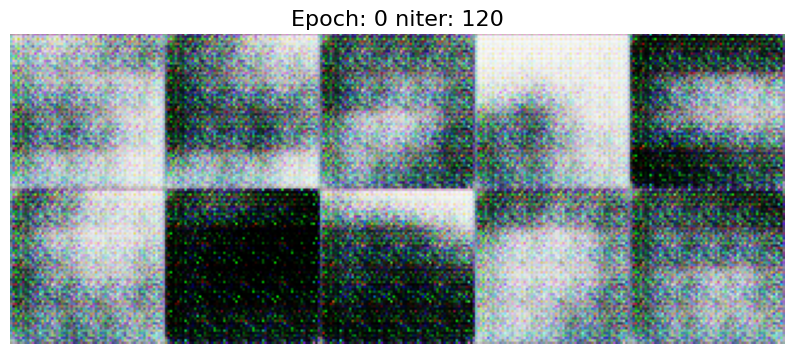

[0/25][120/1000] Loss_D: 0.3839 Loss_G: 2.2802 D(x): 0.7510 D(G(z)): 0.0549 / 0.1116


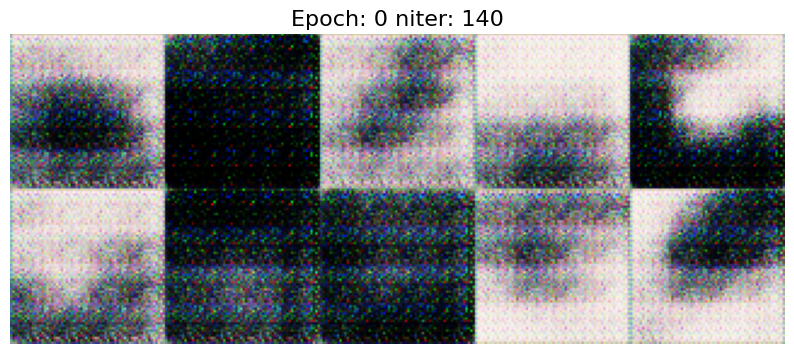

[0/25][140/1000] Loss_D: 0.2525 Loss_G: 4.1644 D(x): 0.8177 D(G(z)): 0.0407 / 0.0200


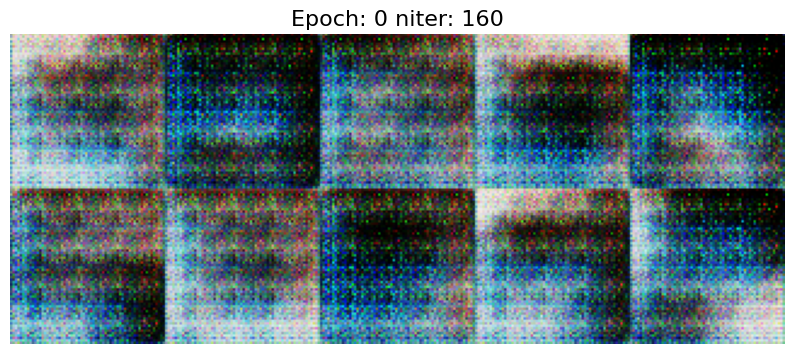

[0/25][160/1000] Loss_D: 1.5583 Loss_G: 3.8270 D(x): 0.3539 D(G(z)): 0.0101 / 0.0407


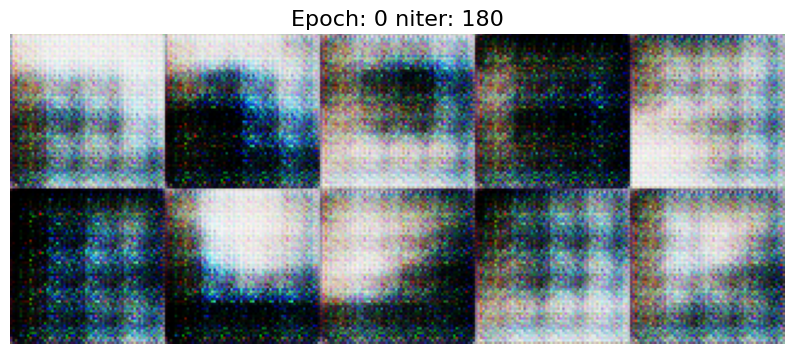

[0/25][180/1000] Loss_D: 0.5897 Loss_G: 7.2626 D(x): 0.9751 D(G(z)): 0.3683 / 0.0011


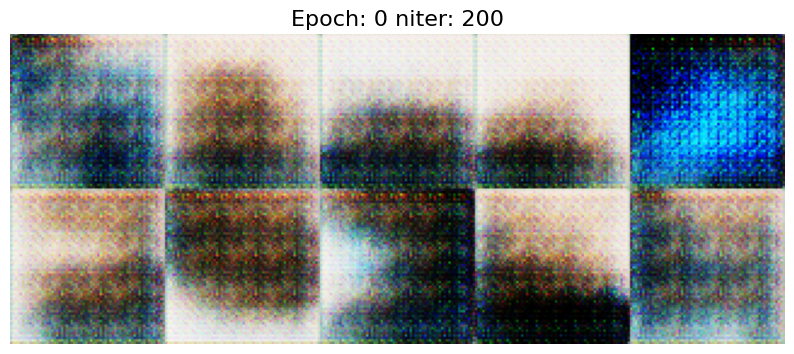

[0/25][200/1000] Loss_D: 0.8769 Loss_G: 1.6865 D(x): 0.5124 D(G(z)): 0.0540 / 0.2425


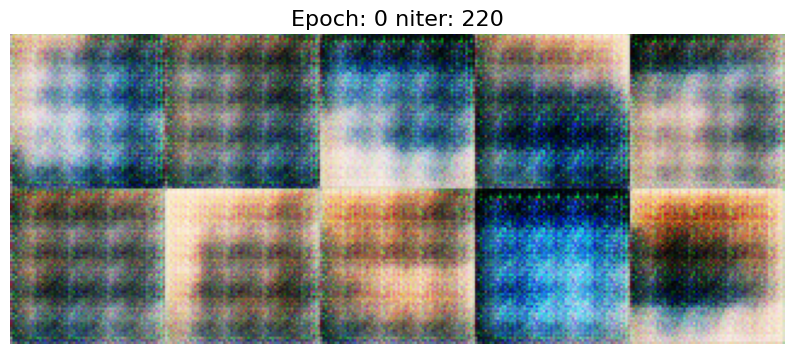

[0/25][220/1000] Loss_D: 0.7408 Loss_G: 3.7996 D(x): 0.9006 D(G(z)): 0.4381 / 0.0291


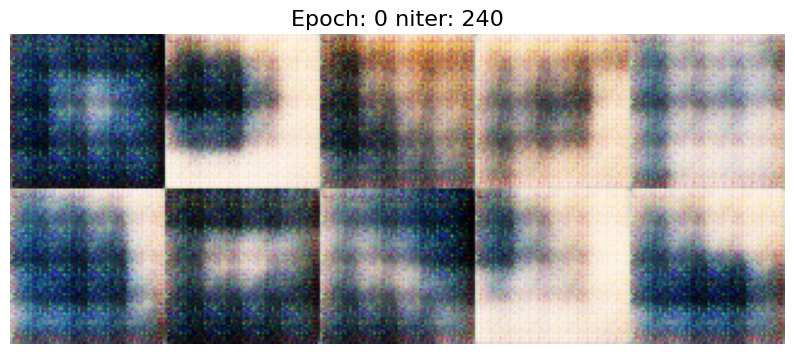

[0/25][240/1000] Loss_D: 3.9658 Loss_G: 2.8392 D(x): 0.0299 D(G(z)): 0.0016 / 0.0788


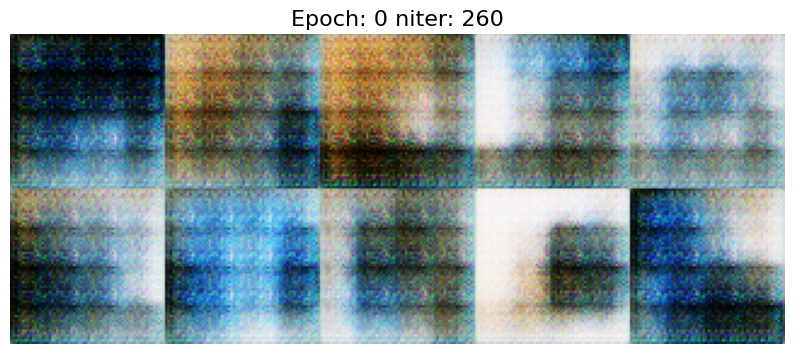

[0/25][260/1000] Loss_D: 0.4680 Loss_G: 2.3219 D(x): 0.7330 D(G(z)): 0.1087 / 0.1186


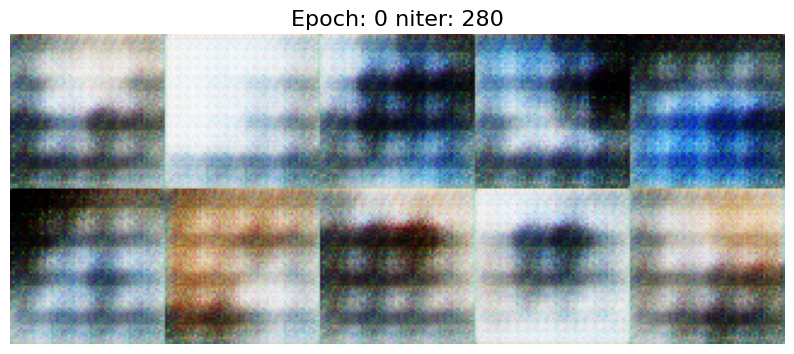

[0/25][280/1000] Loss_D: 0.5942 Loss_G: 1.8395 D(x): 0.6438 D(G(z)): 0.0920 / 0.1866


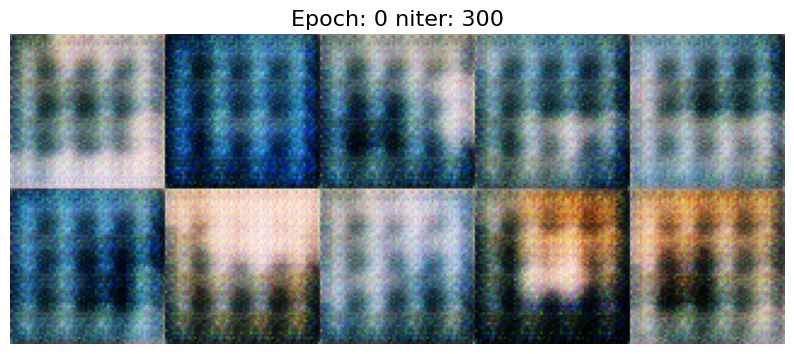

[0/25][300/1000] Loss_D: 0.3006 Loss_G: 2.5220 D(x): 0.8169 D(G(z)): 0.0751 / 0.0920


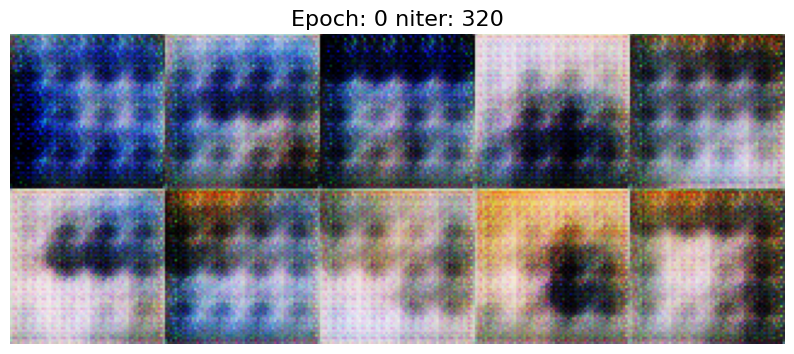

[0/25][320/1000] Loss_D: 0.5048 Loss_G: 3.6786 D(x): 0.6661 D(G(z)): 0.0077 / 0.0358


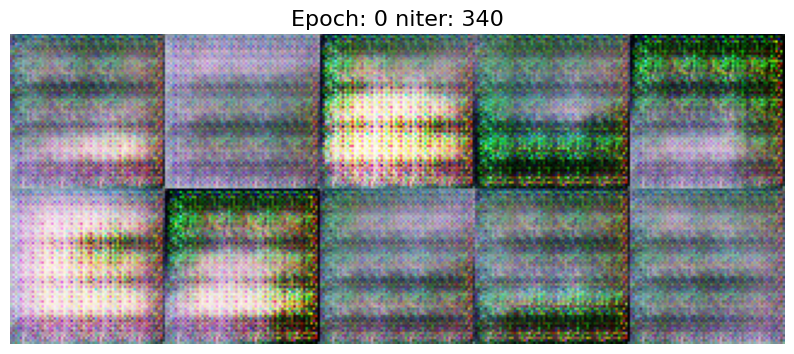

[0/25][340/1000] Loss_D: 0.1768 Loss_G: 6.0785 D(x): 0.9548 D(G(z)): 0.1107 / 0.0032


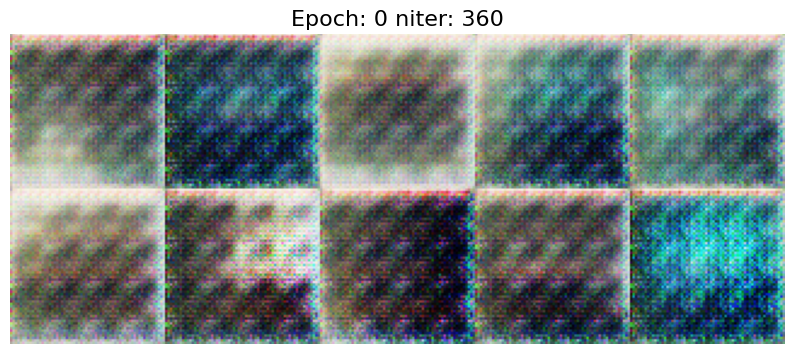

[0/25][360/1000] Loss_D: 0.3344 Loss_G: 12.3528 D(x): 0.9750 D(G(z)): 0.2504 / 0.0000


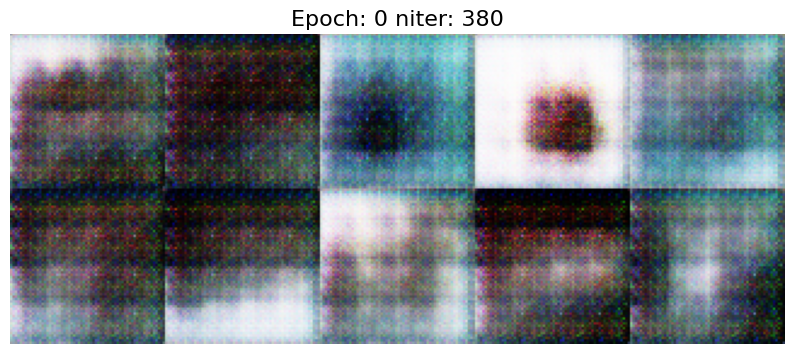

[0/25][380/1000] Loss_D: 0.7131 Loss_G: 2.1399 D(x): 0.6323 D(G(z)): 0.1379 / 0.1723


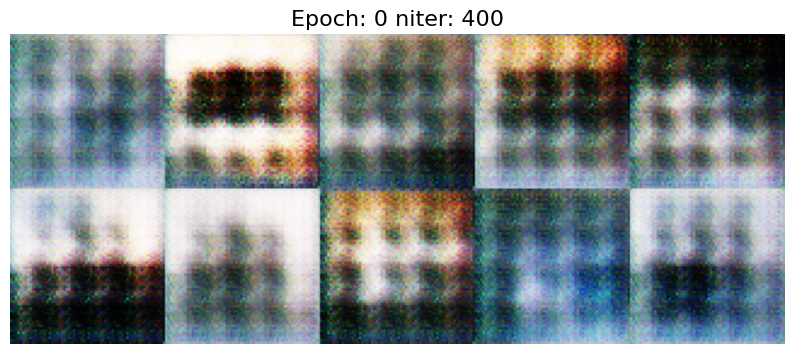

[0/25][400/1000] Loss_D: 0.6156 Loss_G: 5.4843 D(x): 0.8283 D(G(z)): 0.3142 / 0.0052


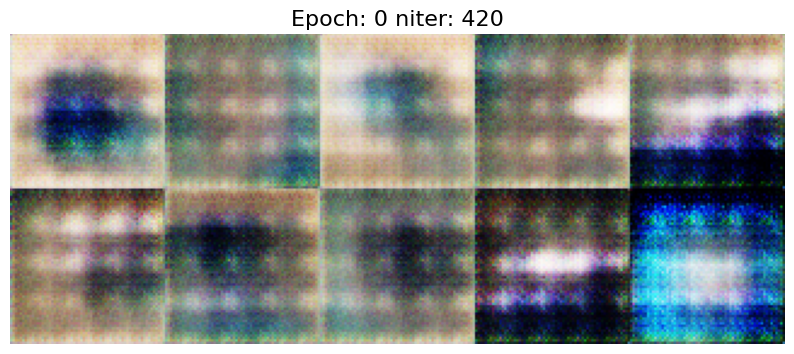

[0/25][420/1000] Loss_D: 0.4534 Loss_G: 3.5959 D(x): 0.8104 D(G(z)): 0.1930 / 0.0359


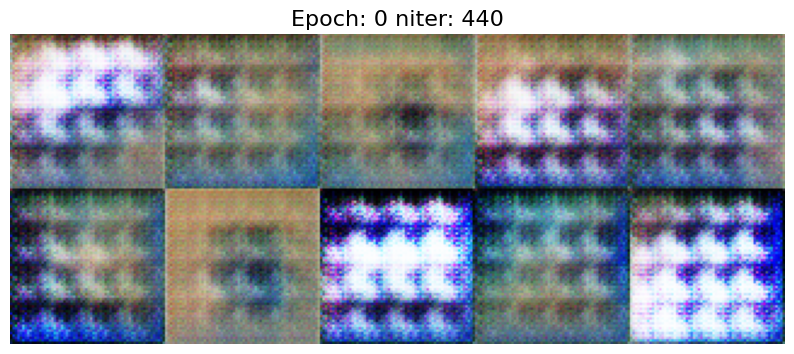

[0/25][440/1000] Loss_D: 0.2753 Loss_G: 6.2770 D(x): 0.9365 D(G(z)): 0.1774 / 0.0032


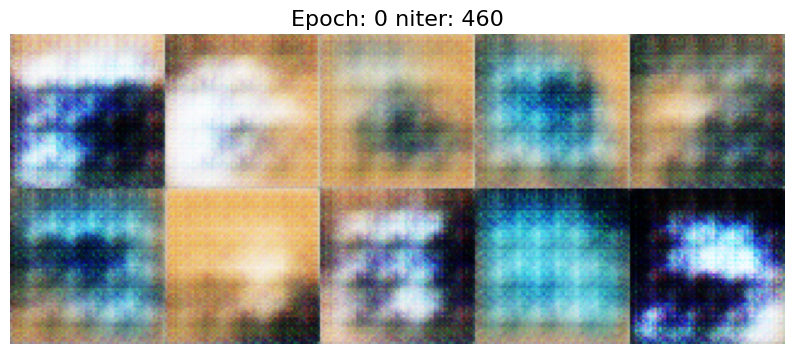

[0/25][460/1000] Loss_D: 0.5458 Loss_G: 3.1020 D(x): 0.8543 D(G(z)): 0.2856 / 0.0571


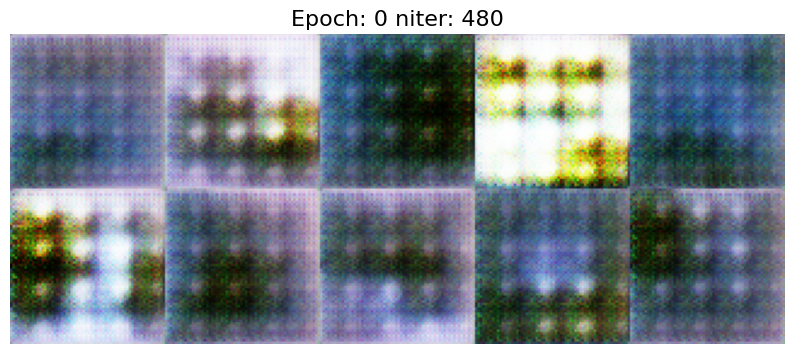

[0/25][480/1000] Loss_D: 0.3020 Loss_G: 3.5209 D(x): 0.8671 D(G(z)): 0.1290 / 0.0338


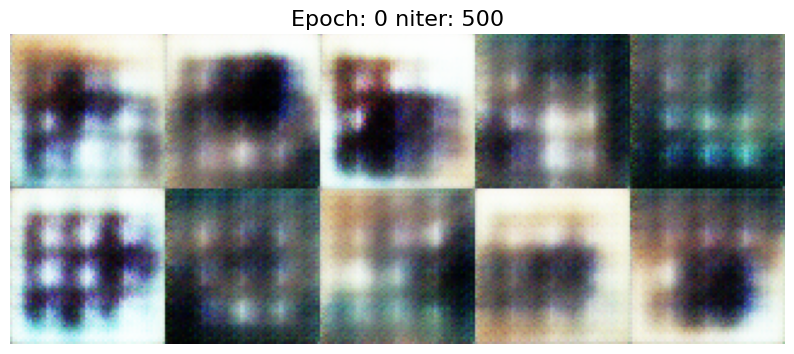

[0/25][500/1000] Loss_D: 1.5081 Loss_G: 3.9014 D(x): 0.9863 D(G(z)): 0.7080 / 0.0367


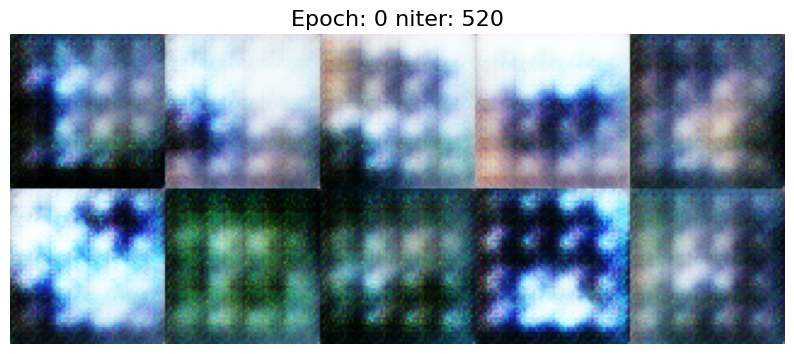

[0/25][520/1000] Loss_D: 0.5135 Loss_G: 2.2270 D(x): 0.7617 D(G(z)): 0.1605 / 0.1398


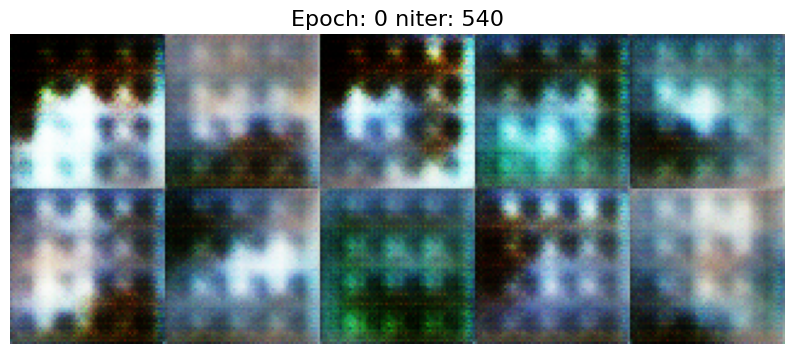

[0/25][540/1000] Loss_D: 0.3629 Loss_G: 3.3257 D(x): 0.7960 D(G(z)): 0.0956 / 0.0473


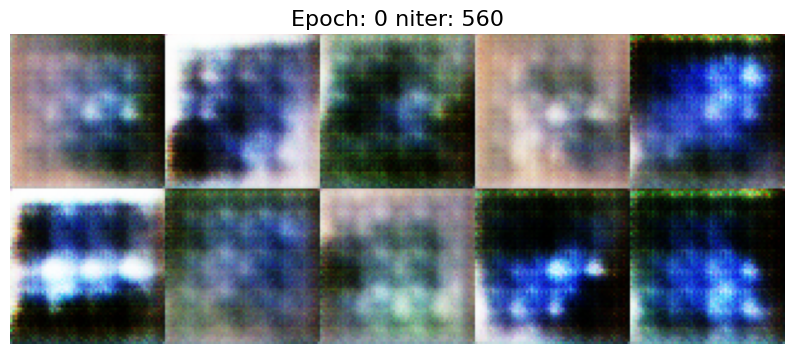

[0/25][560/1000] Loss_D: 0.3228 Loss_G: 3.6285 D(x): 0.8823 D(G(z)): 0.1609 / 0.0360


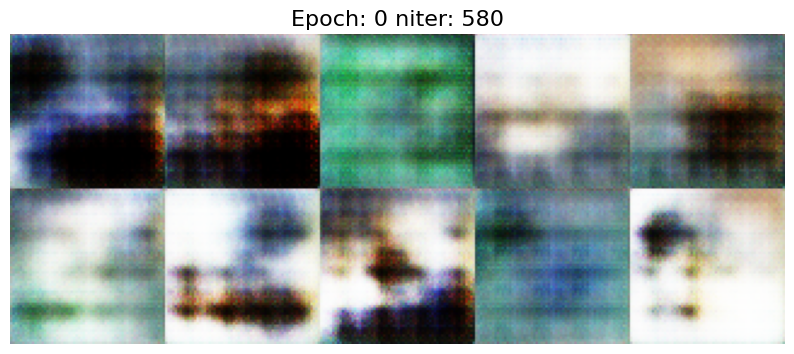

[0/25][580/1000] Loss_D: 0.6787 Loss_G: 2.7740 D(x): 0.6923 D(G(z)): 0.2110 / 0.0888


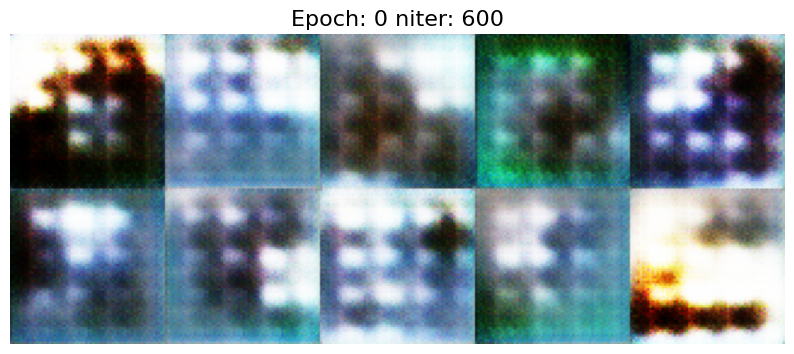

[0/25][600/1000] Loss_D: 0.2994 Loss_G: 2.9618 D(x): 0.8534 D(G(z)): 0.1211 / 0.0662


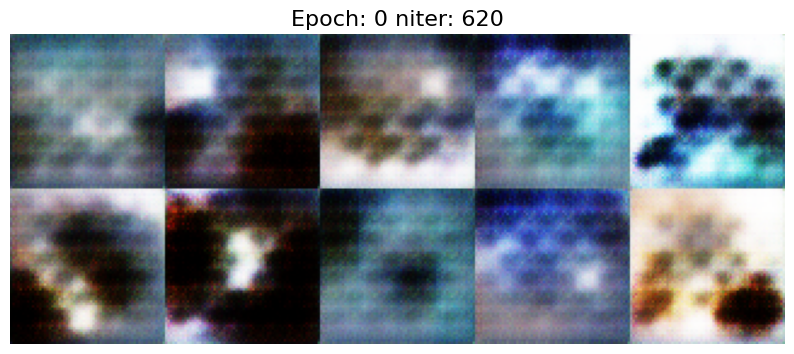

[0/25][620/1000] Loss_D: 0.3480 Loss_G: 3.8827 D(x): 0.9237 D(G(z)): 0.2163 / 0.0244


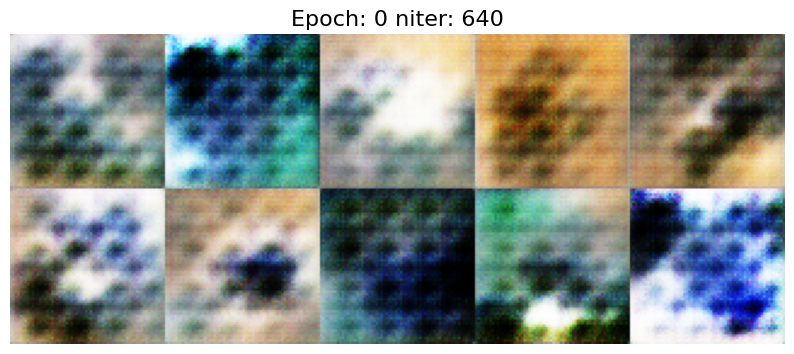

[0/25][640/1000] Loss_D: 0.6274 Loss_G: 4.9253 D(x): 0.8969 D(G(z)): 0.3753 / 0.0096


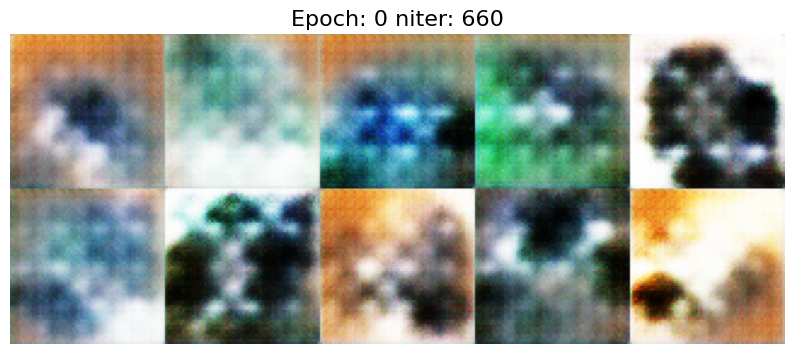

[0/25][660/1000] Loss_D: 0.6642 Loss_G: 4.3868 D(x): 0.8192 D(G(z)): 0.3239 / 0.0163


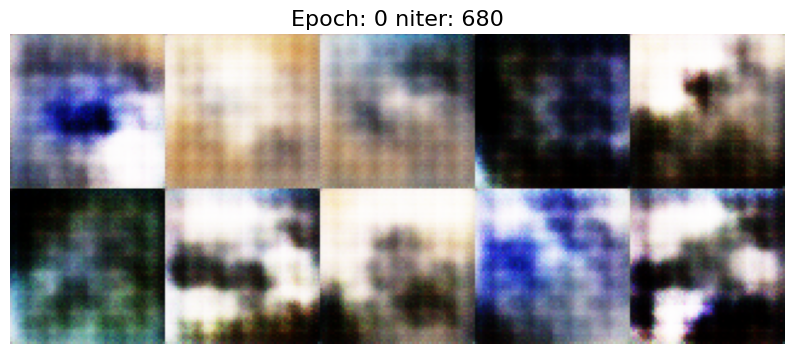

[0/25][680/1000] Loss_D: 0.5298 Loss_G: 2.7328 D(x): 0.7623 D(G(z)): 0.1929 / 0.0828


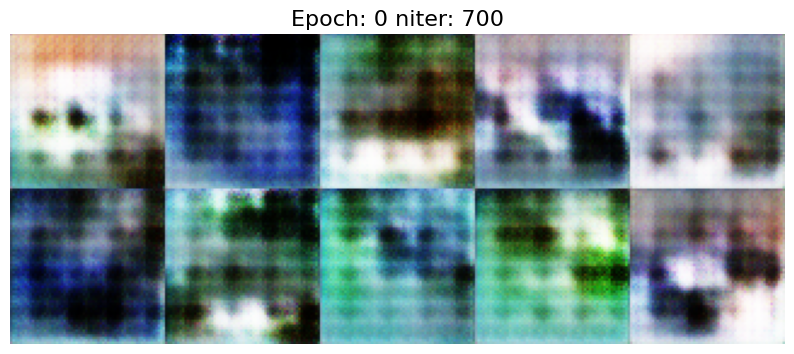

[0/25][700/1000] Loss_D: 0.5048 Loss_G: 2.3614 D(x): 0.7389 D(G(z)): 0.1489 / 0.1182


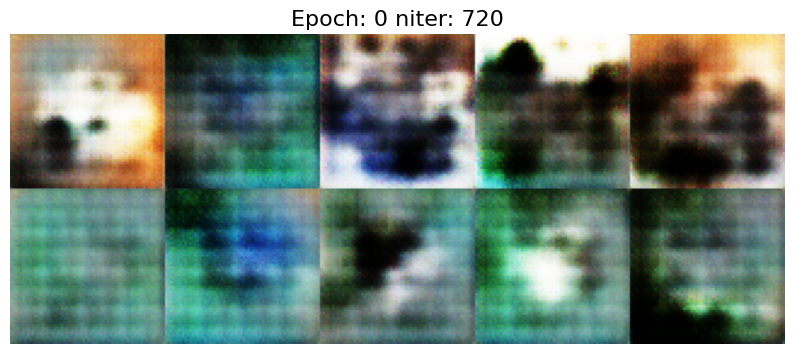

[0/25][720/1000] Loss_D: 0.6808 Loss_G: 4.7332 D(x): 0.9736 D(G(z)): 0.4385 / 0.0115


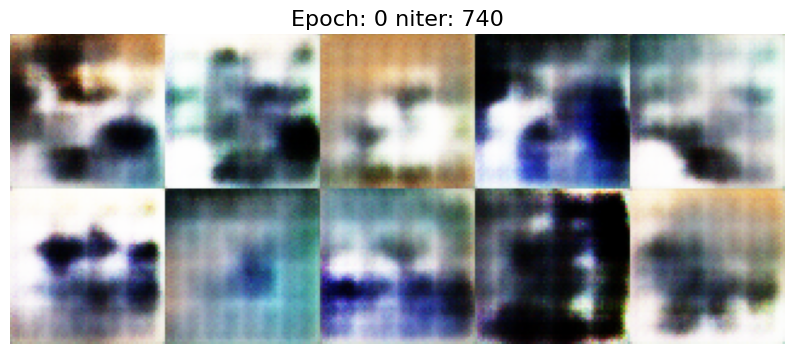

[0/25][740/1000] Loss_D: 0.4158 Loss_G: 3.4166 D(x): 0.7387 D(G(z)): 0.0741 / 0.0485


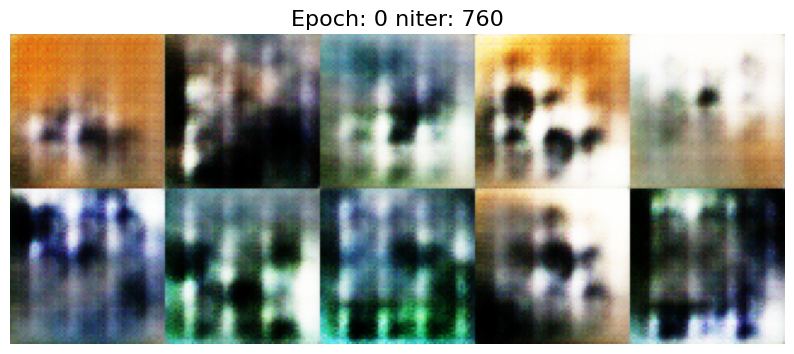

[0/25][760/1000] Loss_D: 0.7078 Loss_G: 4.8295 D(x): 0.8627 D(G(z)): 0.3870 / 0.0105


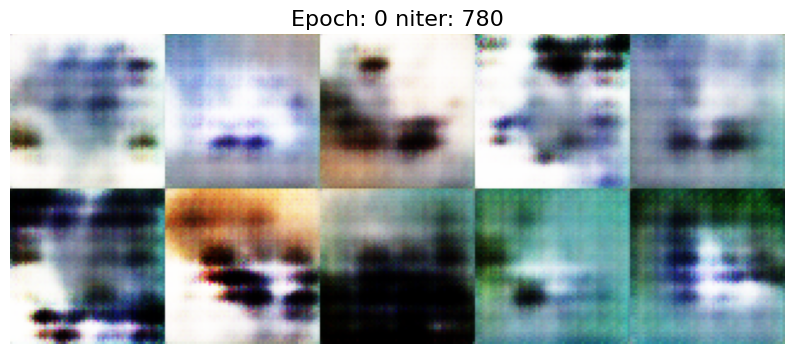

[0/25][780/1000] Loss_D: 0.4714 Loss_G: 3.2063 D(x): 0.7239 D(G(z)): 0.0939 / 0.0560


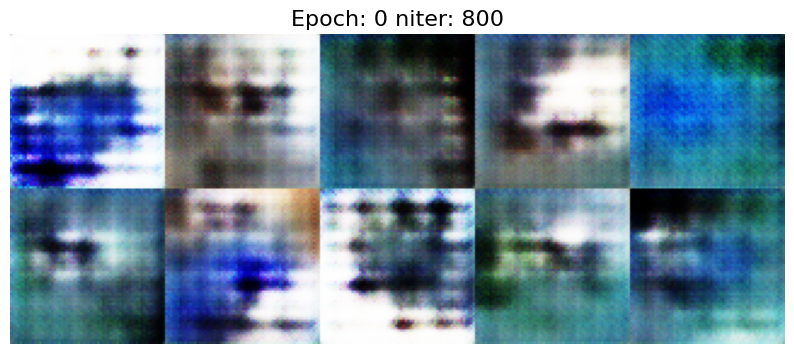

[0/25][800/1000] Loss_D: 0.3902 Loss_G: 3.0555 D(x): 0.8551 D(G(z)): 0.1885 / 0.0663


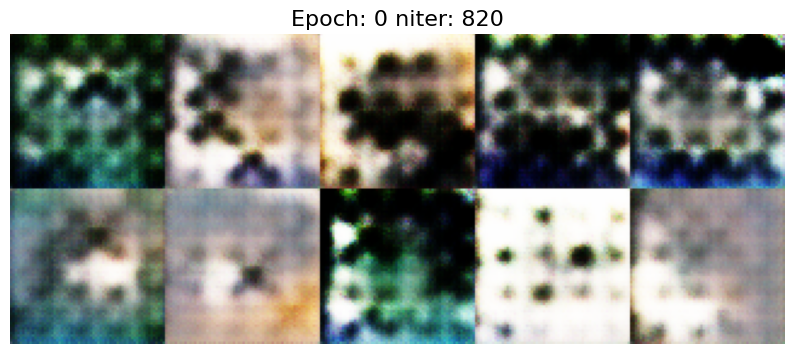

[0/25][820/1000] Loss_D: 0.4494 Loss_G: 3.8229 D(x): 0.8961 D(G(z)): 0.2511 / 0.0314


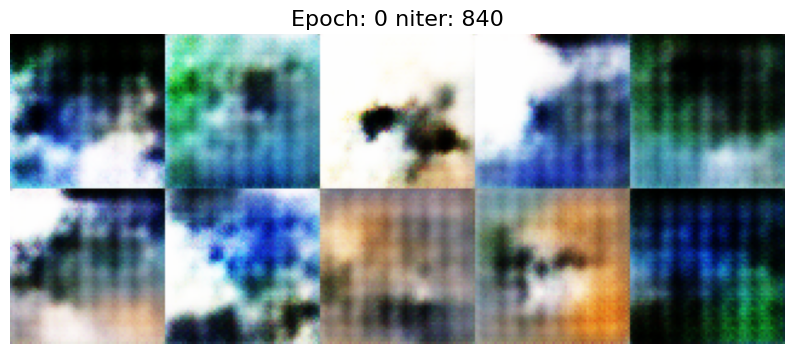

[0/25][840/1000] Loss_D: 0.4927 Loss_G: 3.2281 D(x): 0.6916 D(G(z)): 0.0360 / 0.0579


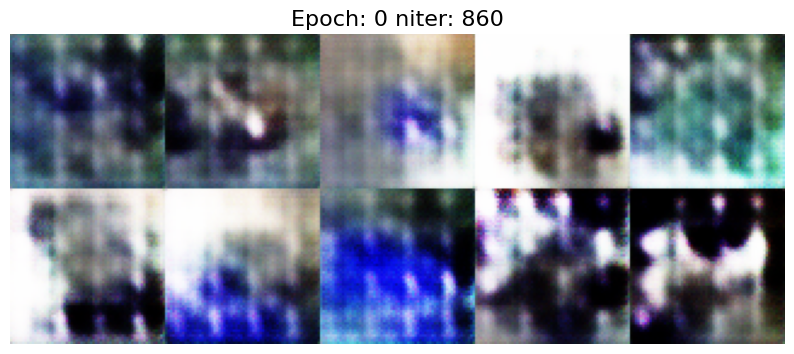

[0/25][860/1000] Loss_D: 0.3170 Loss_G: 2.7039 D(x): 0.8073 D(G(z)): 0.0735 / 0.0939


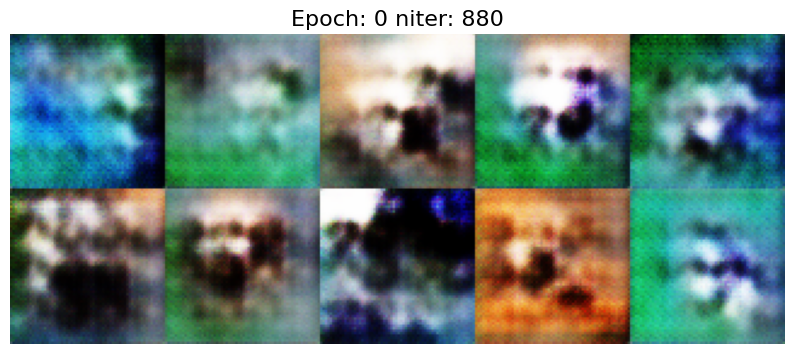

[0/25][880/1000] Loss_D: 0.3403 Loss_G: 3.6209 D(x): 0.9633 D(G(z)): 0.2409 / 0.0368


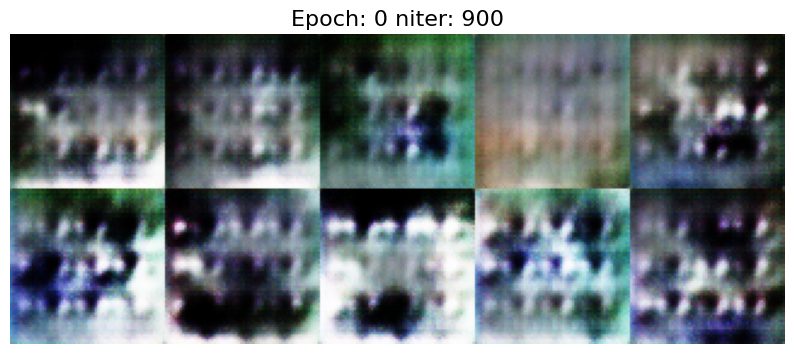

[0/25][900/1000] Loss_D: 0.4096 Loss_G: 2.6074 D(x): 0.7234 D(G(z)): 0.0392 / 0.1058


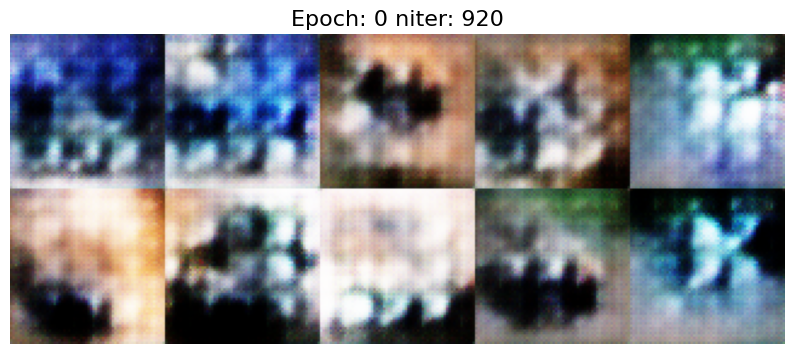

[0/25][920/1000] Loss_D: 0.8924 Loss_G: 1.8151 D(x): 0.6485 D(G(z)): 0.3117 / 0.1913


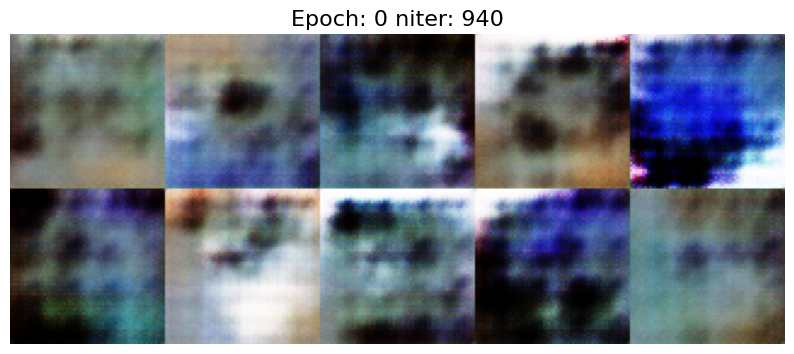

[0/25][940/1000] Loss_D: 0.7956 Loss_G: 1.9117 D(x): 0.5835 D(G(z)): 0.1464 / 0.1856


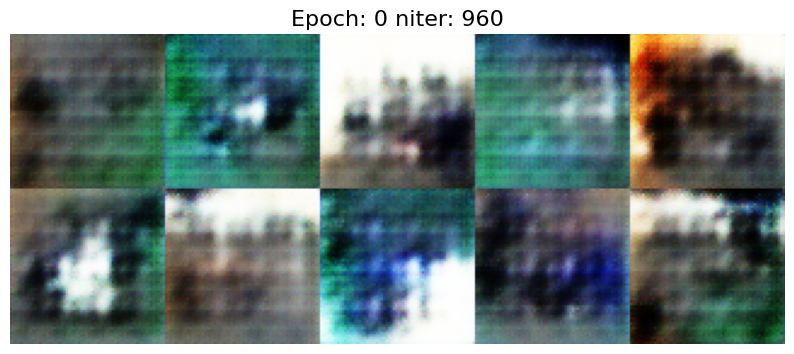

[0/25][960/1000] Loss_D: 0.6040 Loss_G: 3.0009 D(x): 0.7070 D(G(z)): 0.1790 / 0.0782


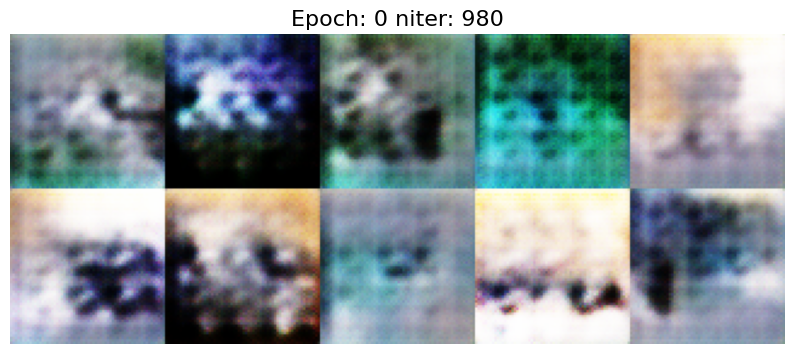

[0/25][980/1000] Loss_D: 0.6173 Loss_G: 5.0960 D(x): 0.9488 D(G(z)): 0.3896 / 0.0086


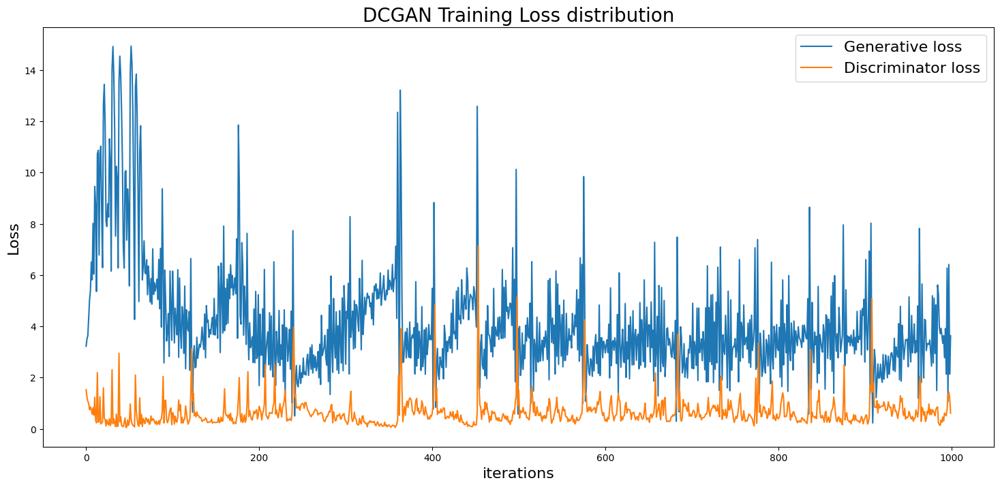

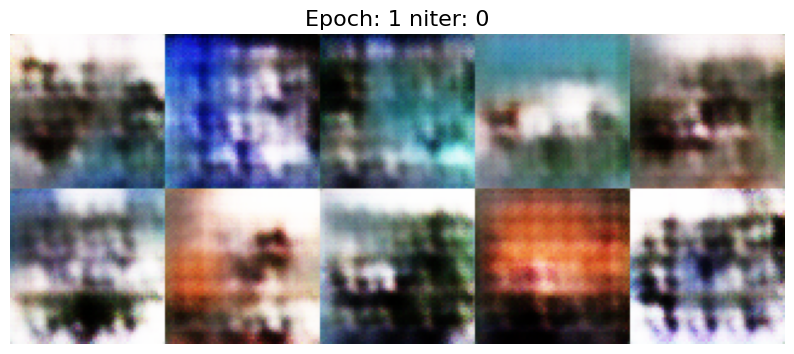

[1/25][0/1000] Loss_D: 0.2706 Loss_G: 4.5374 D(x): 0.8988 D(G(z)): 0.1280 / 0.0156


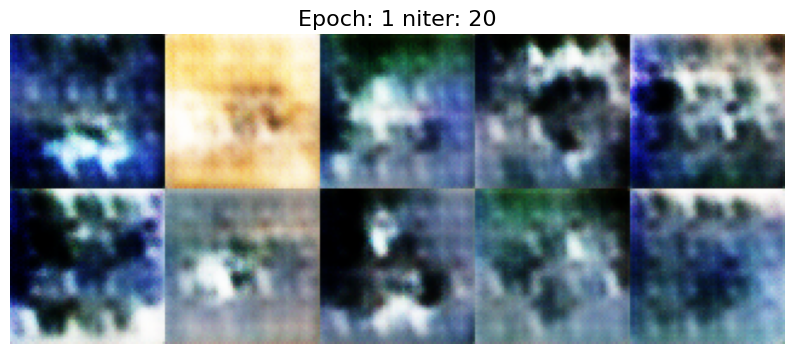

[1/25][20/1000] Loss_D: 1.1586 Loss_G: 2.5931 D(x): 0.3959 D(G(z)): 0.0064 / 0.1015


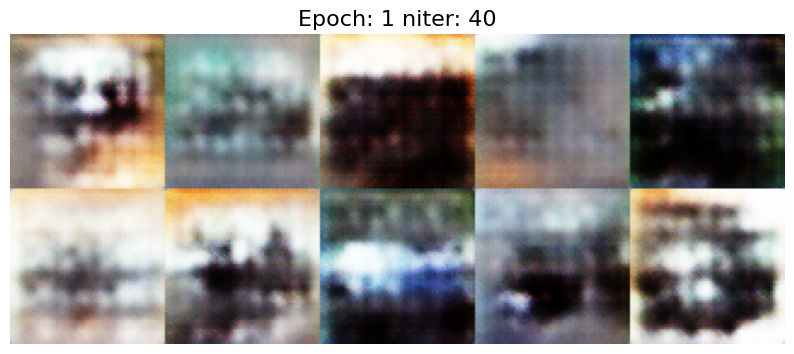

[1/25][40/1000] Loss_D: 0.2762 Loss_G: 4.8016 D(x): 0.9587 D(G(z)): 0.1918 / 0.0115


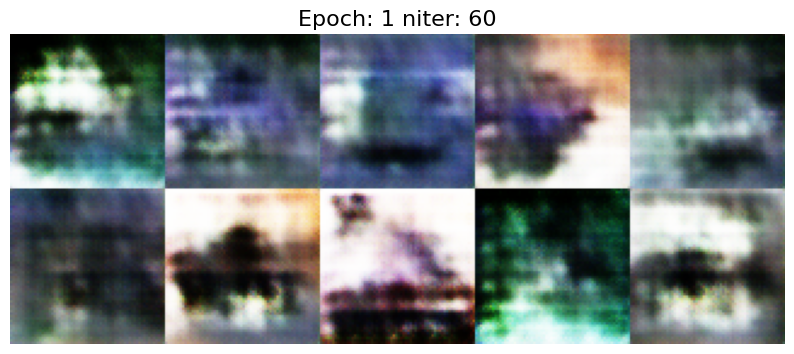

[1/25][60/1000] Loss_D: 0.8147 Loss_G: 5.4902 D(x): 0.9613 D(G(z)): 0.4979 / 0.0058


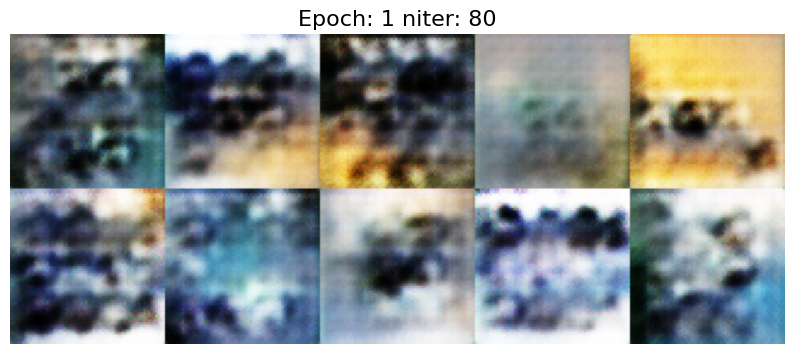

[1/25][80/1000] Loss_D: 0.4987 Loss_G: 2.9439 D(x): 0.6946 D(G(z)): 0.0803 / 0.0907


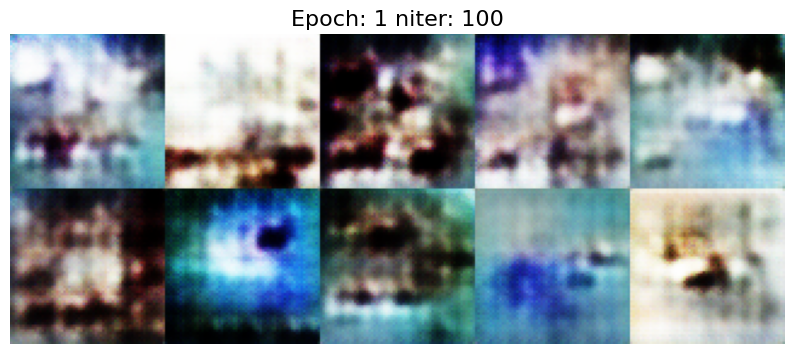

[1/25][100/1000] Loss_D: 1.2021 Loss_G: 2.1507 D(x): 0.4162 D(G(z)): 0.1068 / 0.1418


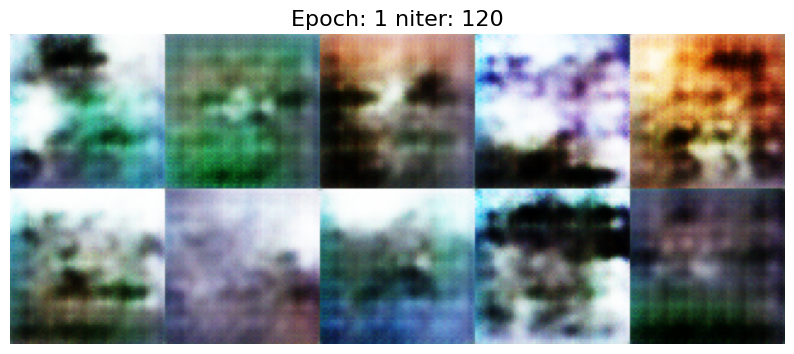

[1/25][120/1000] Loss_D: 0.5622 Loss_G: 2.8572 D(x): 0.8837 D(G(z)): 0.3196 / 0.0721


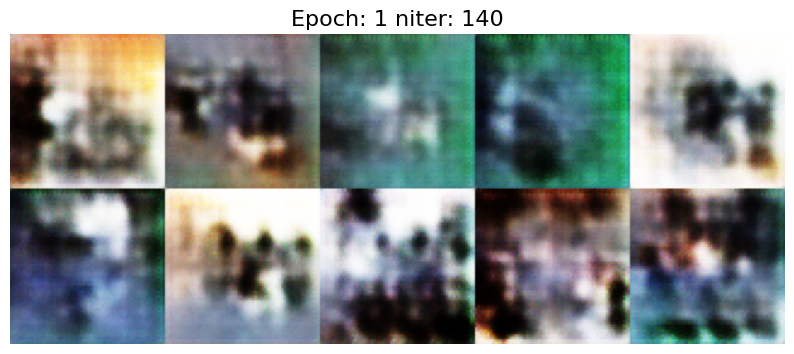

[1/25][140/1000] Loss_D: 1.2960 Loss_G: 1.1428 D(x): 0.3447 D(G(z)): 0.0293 / 0.3949


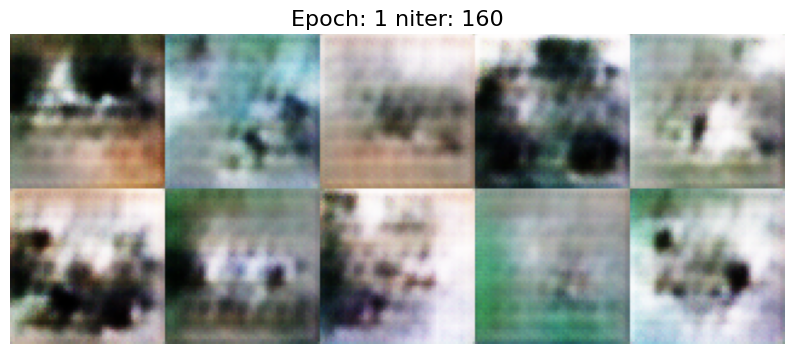

[1/25][160/1000] Loss_D: 0.2435 Loss_G: 3.9744 D(x): 0.9046 D(G(z)): 0.1212 / 0.0238


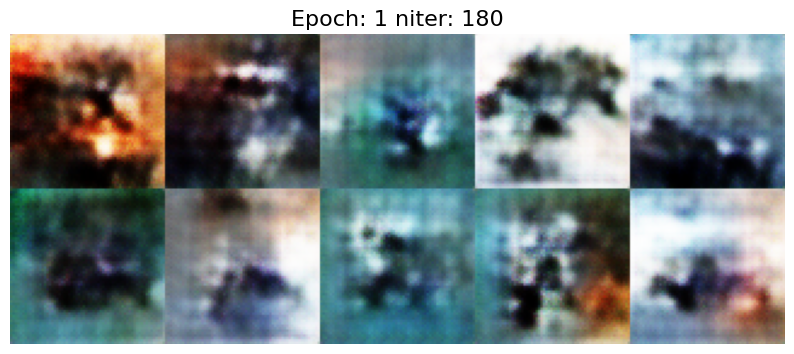

[1/25][180/1000] Loss_D: 2.3963 Loss_G: 2.0822 D(x): 0.1714 D(G(z)): 0.0132 / 0.1642


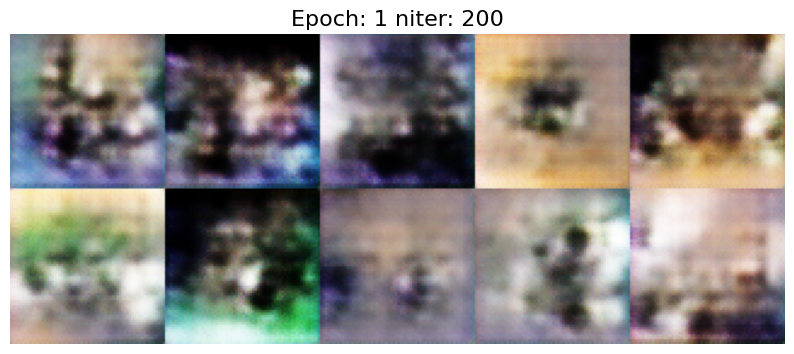

[1/25][200/1000] Loss_D: 0.4916 Loss_G: 2.5348 D(x): 0.6871 D(G(z)): 0.0733 / 0.0968


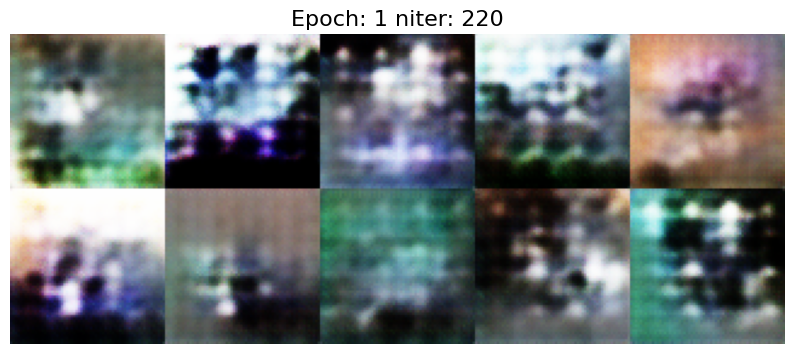

[1/25][220/1000] Loss_D: 0.5957 Loss_G: 2.3422 D(x): 0.6869 D(G(z)): 0.1516 / 0.1162


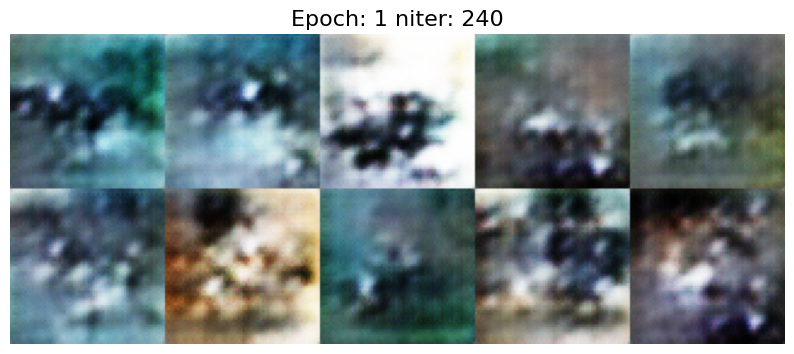

[1/25][240/1000] Loss_D: 0.7504 Loss_G: 3.0563 D(x): 0.5358 D(G(z)): 0.0187 / 0.0669


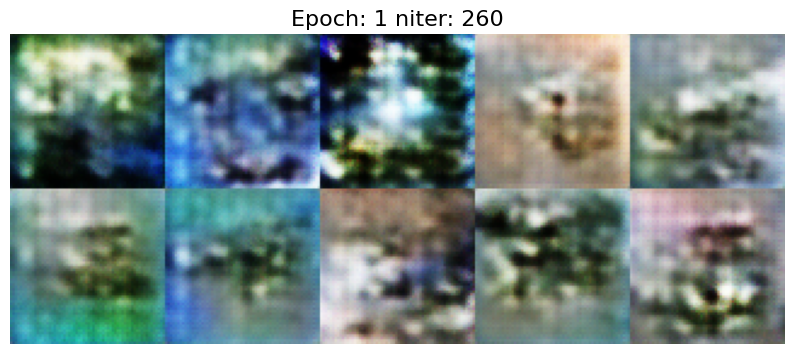

[1/25][260/1000] Loss_D: 0.7440 Loss_G: 3.0519 D(x): 0.8509 D(G(z)): 0.4002 / 0.0601


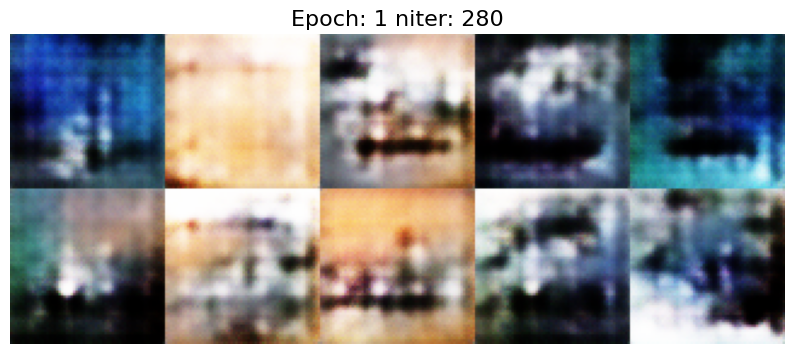

[1/25][280/1000] Loss_D: 1.2039 Loss_G: 6.0152 D(x): 0.9878 D(G(z)): 0.6415 / 0.0032


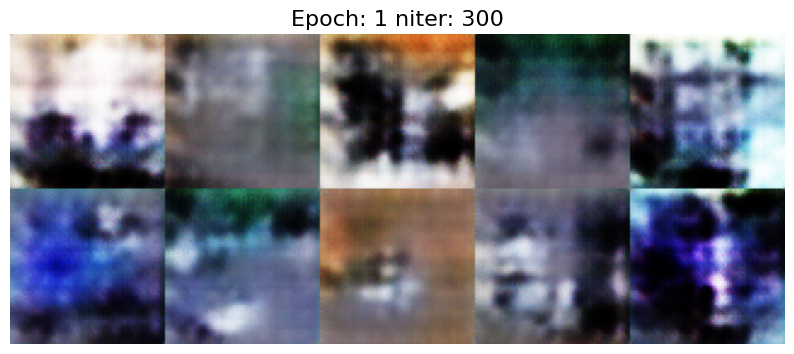

[1/25][300/1000] Loss_D: 0.9170 Loss_G: 2.4978 D(x): 0.4885 D(G(z)): 0.0707 / 0.1193


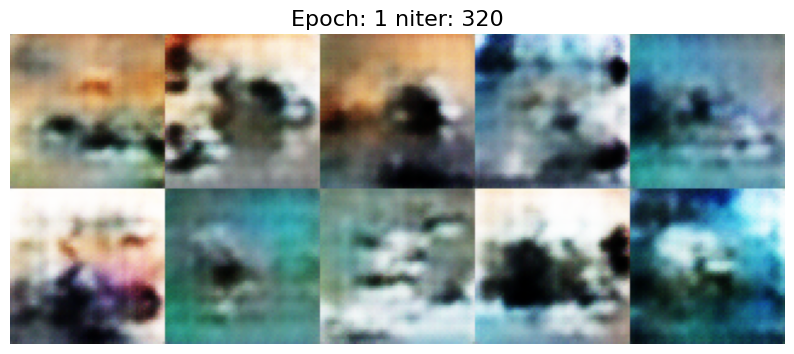

[1/25][320/1000] Loss_D: 0.5078 Loss_G: 3.0160 D(x): 0.6601 D(G(z)): 0.0350 / 0.0790


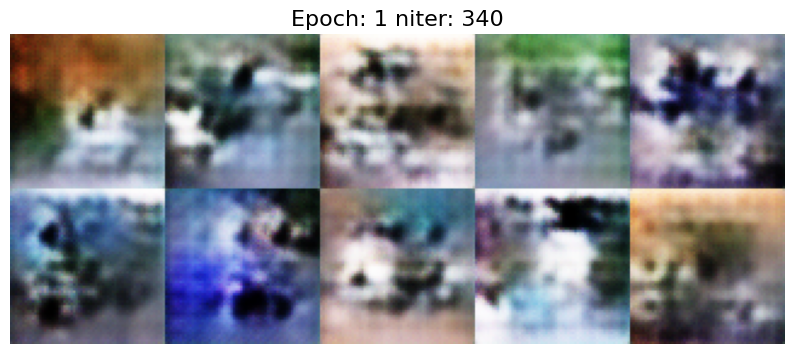

[1/25][340/1000] Loss_D: 0.5572 Loss_G: 3.5095 D(x): 0.8255 D(G(z)): 0.2704 / 0.0413


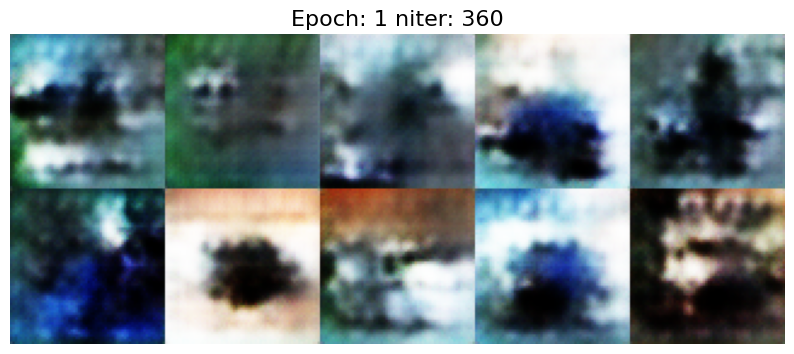

[1/25][360/1000] Loss_D: 0.1523 Loss_G: 3.7938 D(x): 0.9639 D(G(z)): 0.1029 / 0.0291


In [ ]:
'''
Training
'''
G_period = 1
G_loss_list = []
D_loss_list  = []
lr_list = []

print('start training...')
for epoch in range(EPOCH):
    for i, data in enumerate(dataloader):

        D.zero_grad()
        real_data = data[0].to(device)
        label = torch.full((BATCH,1,1,1), real_label, device=device)
        # test_D = real_data[0].detach().permute(1,2,0).cpu().numpy()
        # plt.imshow(test_D)
        output = D(real_data)
        loss_real = criterion(output, label)
        loss_real.backward()
        D_x = output.mean().item()
        
        
        # train with fake
        noise = torch.randn(BATCH, NOISE, 1, 1, device=device)
        fake = G(noise)
        label.fill_(fake_label)
        # test_G = fake[0].detach().permute(1,2,0).cpu().numpy()
        # plt.imshow(test_G)
        output = D(fake.detach())
        loss_fake = criterion(output, label)
        loss_fake.backward()
        D_G_z1 = output.mean().item()
        D_loss = loss_real + loss_fake
        D_loss_list.append(D_loss.item())
        optimizerD.step()
    
        
        for j in range(G_period):

            G.zero_grad()
            label.fill_(real_label) 
            output = D(fake)
            G_loss = criterion(output, label)
            G_loss_list.append(G_loss.item())
            G_loss.backward()
            D_G_z2 = output.mean().item()
            optimizerG.step()
            
            fake = G(noise)
            
            
            
        if i % (len(dataloader)//50) == 0:
            D.eval()
            G.eval()
            noise = torch.randn(10, NOISE, 1, 1, device=device)
            fake_images = G(noise)
            frames = G_fake_images(fake_images)
            plt.figure(figsize=(10,10))
            plt.imshow(frames)
            plt.axis('off')
            plt.title('Epoch: %d niter: %d'%(epoch,i),fontsize=16)
            plt.show()
            
            print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f' % (
                epoch, EPOCH, i, len(dataloader), D_loss.item(), G_loss.item(), D_x, D_G_z1, D_G_z2))

            D.train()
            G.train()
    
    
        
    #save for every epoch
    plt.figure(figsize=(18,8))
    plt.plot(G_loss_list, label='Generative loss')
    plt.plot(D_loss_list, label='Discriminator loss')
    plt.xlabel('iterations',fontsize=16)
    plt.ylabel('Loss',fontsize=16)
    plt.title('DCGAN Training Loss distribution',fontsize=20)
    plt.legend(fontsize=16)
    plt.show()
    torch.save(G.state_dict(), './weights/DCGAN_G_test.pth')
    torch.save(D.state_dict(), './weights/DCGAN_D_test.pth')


#save model
time_end_all = time.time()
print('Done! Totoal time cost: ',time_end_all-time_start_all)
t = time.strftime("%Y%m%d_%H%M", time.localtime()) 
torch.save(G.state_dict(), './weights/DCGAN_G_'+t+'.pth')
torch.save(D.state_dict(), './weights/DCGAN_D_'+t+'.pth')

In [ ]:

def test_model(num_image):
    D.eval()
    G.eval()
    
    best_image = []
    index = 0
    
    while index < num_image:
        noise = torch.randn(1, NOISE, 1, 1, device=device)
        test_image = G(noise)
        score = D(test_image).detach().cpu().numpy()[0][0][0][0]
        
        if score > 0.9:
            print(score)
            image = test_image.detach().permute(0,2,3,1).cpu().numpy()[0]
            best_image.append(norm(image))
            index = index +1
            
    return best_image

best_image = test_model(10)



def show_images(image_list):
    n = len(image_list)

    col = 5
    row = n//col
    
    frames = np.array([])
    for i in range(row):
        frame_row = np.array([])
        for j in range(col):
            frame_i = image_list[i*col + j]
            if j==0: frame_row = frame_i
            else: frame_row = np.hstack((frame_row,frame_i))
        
        if i==0: frames = frame_row
        else: frames = np.vstack((frames,frame_row))
    
    return frames
   
frames = show_images(best_image)      

plt.figure(figsize=(10,10))
plt.imshow(frames)
plt.axis('off')
plt.title('DCGAN Best after 25 Epochs)
plt.legend(fontsize=20)
plt.savefig('DCGAN_image_wall_plot.png')
plt.show() 
cv2.imwrite('DCGAN_image_wall.png', cv2.cvtColor(frames, cv2.COLOR_BGR2RGB))